<h1 style="text-align:center">Quick and Easy Standalone Webmaps Using GeoPandas</h1>

<p style="font-size:24px; text-align:center">
NNIP Idea Showcase<br />
June 20, 2024<br />
</p>

<p style="text-align:center">
    <a href="mailto:aporr@morpc.org">Adam Porr</a><br />
    Research & Data Officer<br />
    <a href="https://morpc.org">Mid-Ohio Regional Planning Commission</a>
</p>

## Abstract

Lots of great third-party platforms are available which allow users to create interactive webmaps to present spatial data including ArcGIS Online, Google Maps, and Mapbox.  These services are appropriate for many use cases, however some situations may warrant a standalone webmap that is not reliant on a third party platform.  Such situations might include budget constraints, special access control requirements, special user interface requirements, the desire to package the content or implement version control, or the need to access the webmap in an environment without internet access.  In such cases, it is possible to develop a standalone webmap from scratch using frameworks such as Leaflet or OpenLayers, however this can be time consuming and it requires knowledge of Javascript programming and web server administration. Luckily, the excellent GeoPandas package for Python provides a means of producing basic webmaps that is more accessible to Python programmers and avoids much of the complexity and tedium of building the webmap from scratch. This presentation demonstrates how to automatically produce an interactive standalone webmap from U.S. Census data using GeoPandas. The workflow is implemented using Jupyter to allow for convenient  prototyping the webmap prior to production.  The presentation also covers how to make the webmap accessible to the public using GitHub Pages. 

Attendee familiarity with Python, Jupyter, and GitHub is helpful but not required.

## Agenda

  1. Motivation
  1. Process overview and prerequisites
  1. Data preparation *(skipped, but included in documents)*
  1. Demo of webmap creation  and export
  1. Demo of webmap publishing using GitHub Pages

## How to access the content from this presentation

All of the content presented today is publicly available in GitHub:

https://github.com/aporr/easy-webmaps-with-jupyter

The slides are available directly from the following URL:

https://aporr.github.io/easy-webmaps-with-jupyter/slides.html

The slides are implemented using Reveal.js, which [arranges slides in a 2D layout](https://revealjs.com/vertical-slides/).  Press `PGDN` to move to the next slide or `PGUP` to move to previous slide, or press `ESC` to see an overview and move through the slides non-linearly.

The webmap is available directly from the following URL:

https://aporr.github.io/easy-webmaps-with-jupyter/webmap.html

## GeoPandas can make simple webmaps quickly and easily

![Example webmap screenshot](./images/access_webmap-01.png)

## Why would I want a standalone webmap?

  1. You **can't afford to use a commercial service**.
  1. You need to **share a sensitive map** with parties who cannot access a commercial service.
  1. You want to **hand over the completed map** so you aren't obligated to host it indefinitely.
  1. You want the map to include **fancy features** that the commercial services don't support. 
  1. You want to **automate production** of the map.
  1. You want to use **revision control** (e.g. git).
  1. You want to **embed the map in a custom app** more seamlessly

## What are the steps?

  1. Set up the environment
  1. Prepare the data
  1. Prototype the webmap using Jupyter
  1. Export the webmap to a standalone HTML file
  1. Publish the HTML file on a webserver

# Prerequisites

  - Python 3.x
  - GeoPandas library
  - Jupyter (optional, but helpful for prototyping)
  - GitHub acccount (optional, if you wish to publish using GitHub)
  - Webserver (optional, if you wish to publish without GitHub)
  - Enough Python and GitHub knowledge to adapt this notebook for your purposes

# Demo of webmap creation and export

There are no slides to accompany this section since it was presented as a live demonstration. For implementation details, refer to the Jupyter notebook.

## Prepare the environment

In [194]:
import pandas as pd        # For manipulating tabular data
import geopandas as gpd    # Extension of pandas for manipulating spatial data
import requests            # For retrieving data from the Census API
import json                # For transforming data from the Census API
import os                  # For manipulating files

## Prepare the data

### Load tract geographies

In [227]:
tractsRaw = gpd.read_file("https://www2.census.gov/geo/tiger/TIGER2022/TRACT/tl_2022_39_tract.zip")

In [228]:
tracts = tractsRaw.loc[
        (tractsRaw["STATEFP"] == '39') &
        (tractsRaw["COUNTYFP"] == '049')
    ].copy() \
    .filter(items=["GEOID","geometry"], axis="columns") \
    .set_index("GEOID") \
    .to_crs("epsg:3735")
tracts.head()

,geometry
GEOID,
39049006392,"POLYGON ((1812678.020 769514.607, 1812796.958 ..."
39049006500,"POLYGON ((1805161.518 730017.428, 1805222.134 ..."
39049006600,"POLYGON ((1806233.249 728073.229, 1806465.314 ..."
39049006710,"POLYGON ((1822275.804 759052.354, 1822275.413 ..."
39049006721,"POLYGON ((1818673.740 766164.975, 1818684.280 ..."


<AxesSubplot:>

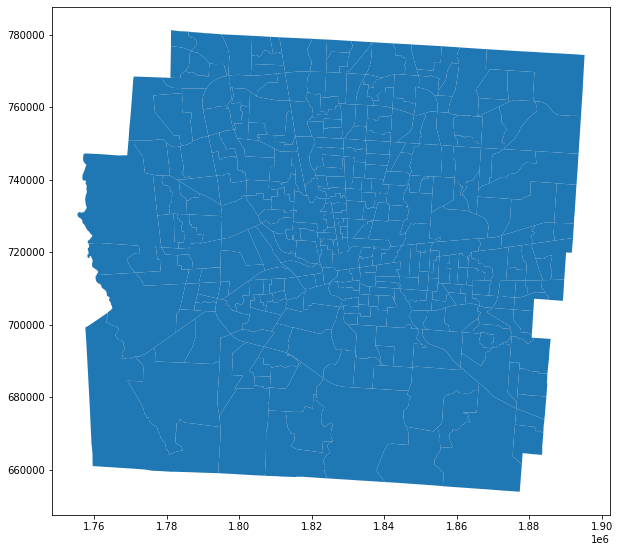

In [229]:
tracts.plot(figsize=(10,10))

### Load means of transportation by Census tract

In [89]:
commuteVars = {
    "B08141_001E":"Workers 16 and over in households",
    "B08141_002E":"No vehicles available",
    "B08141_003E":"1 vehicle available",
    "B08141_004E":"2 vehicles available",
    "B08141_005E":"3 vehicles available",
    "B08141_006E":"Drove alone",
    "B08141_011E":"Carpooled",
    "B08141_016E":"Public transportation",
    "B08141_021E":"Walked",
    "B08141_026E":"Commute by other means",
    "B08141_035E":"Worked from home"
}

In [19]:
r = requests.get("https://api.census.gov/data/2022/acs/acs5?get=group(B08141)&ucgid=pseudo(0500000US39049$1400000)")

In [161]:
headers = r.json()[0]
commuteRaw = pd.DataFrame.from_records(r.json()[1:], columns=headers)
commute = commuteRaw.copy()
commute["GEOID"] = commute["GEO_ID"].apply(lambda x:x.split("US")[1])
commute = commute \
    .set_index("GEOID") \
    .filter(items=commuteVars.keys(), axis="columns") \
    .rename(columns=commuteVars) \
    .astype("int")
commute["No vehicles available (%)"] = commute["No vehicles available"].div(commute["Workers 16 and over in households"], fill_value=0).mul(100, fill_value=0)

In [161]:
commute.head()

### Load Central Ohio bikeways

In [237]:
firstTime = True
offset = 0
exceededLimit = True
recordCount = 2000
while exceededLimit:
    print("Downloading records {} to {}".format(offset+1, offset + recordCount))
    r = requests.get("https://services1.arcgis.com/EjjnBtwS9ivTGI8x/arcgis/rest/services/Bikeways_CentralOhio/FeatureServer/1/query?outFields=*&where=1%3D1&f=geojson&outSR=3735&resultOffset={}&resultRecordCount={}".format(offset, recordCount))
    result = r.json()

    temp = gpd.GeoDataFrame.from_features(result["features"], crs="epsg:3735")
    if firstTime:
        trailsRaw = temp.copy()
        firstTime = False
    else:
        trailsRaw = pd.concat([trailsRaw, temp], axis="index")

    offset += 2000

    if "properties" in result:
        if "exceededTransferLimit" in result["properties"]:
            if result["properties"]["exceededTransferLimit"]:
                exceededLimit = True
    else:
        exceededLimit = False
        print("All records downloaded")

All records downloaded


In [286]:
trails = trailsRaw.loc[trailsRaw["FacilityStatus"] != "REM"].copy() \
    .filter(items=["FacilityStatus","FacilityType","geometry"]) \
    .to_crs("epsg:3735")
trails["FacilityStatus"]  = trails["FacilityStatus"].map({
    "EX":"Existing",
    "COM":"Committed",
    "PRO":"Proposed",
    "UND":"Under construction"
})
trails["FacilityType"]  = trails["FacilityType"].map({
    'PS': 'Paved Shoulder',
    'RT': 'Signed Bicycle Route',
    'SH': 'Shared Lane Markings',
    'BB': 'Bicycle Boulevard',
    'MBT': 'Mountain Bike Trail',
    'STR': 'Street Crossing',
    'PC': 'Pedestrian Connector',
    'PATH': 'Multi-use Path',
    'PT': 'Pedestrian Trail',
    'PRO': 'Proposed',
    'COM': 'Committed',
    'NONE': 'No Connection',
    'LANE': 'Bicycle Lane',
    'PBL': 'Protected Bicycle Lane'
})
trails.head()

,FacilityStatus,FacilityType,geometry
0,Proposed,Proposed,"LINESTRING (1815340.339 887243.451, 1815290.44..."
1,Proposed,Proposed,"LINESTRING (1803621.977 887185.603, 1803652.13..."
2,Proposed,Proposed,"LINESTRING (1813076.868 887400.211, 1812935.86..."
3,Proposed,Proposed,"LINESTRING (1802465.467 886678.783, 1803540.35..."
4,Proposed,Proposed,"LINESTRING (1784373.787 886500.139, 1783966.76..."


<AxesSubplot:>

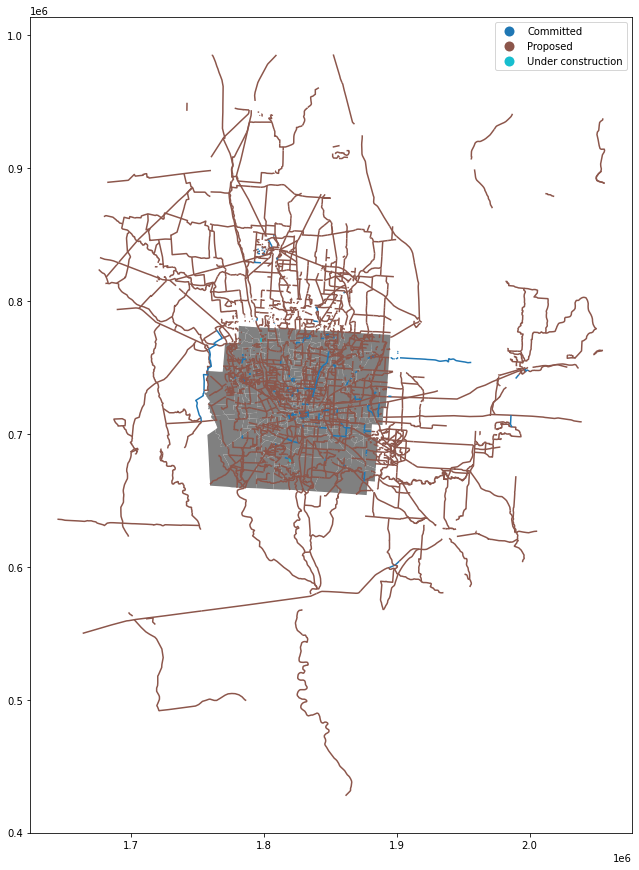

In [282]:
ax = tracts.plot(color="gray", figsize=(15,15))
trails.plot(ax=ax, column="FacilityStatus", legend=True)

### Join means of transportation to tract geographies

In [267]:
tractsEnriched = tracts.join(commute)
tractsEnriched.head()

,geometry,Workers 16 and over in households,No vehicles available,1 vehicle available,2 vehicles available,3 vehicles available,Drove alone,Carpooled,Public transportation,Walked,Commute by other means,Worked from home,No vehicles available (%)
GEOID,,,,,,,,,,,,,
39049006392,"POLYGON ((1812678.020 769514.607, 1812796.958 ...",2052,0,137,1208,707,1398,62,14,0,51,92,0.000000
39049006500,"POLYGON ((1805161.518 730017.428, 1805222.134 ...",1597,4,225,1070,298,1125,64,0,11,0,85,0.250470
39049006600,"POLYGON ((1806233.249 728073.229, 1806465.314 ...",2097,0,130,1311,656,1431,96,10,51,33,103,0.000000
39049006710,"POLYGON ((1822275.804 759052.354, 1822275.413 ...",1469,16,312,853,288,1186,107,0,42,0,48,1.089176
39049006721,"POLYGON ((1818673.740 766164.975, 1818684.280 ...",1893,0,185,1241,467,1482,44,0,54,21,40,0.000000


<AxesSubplot:>

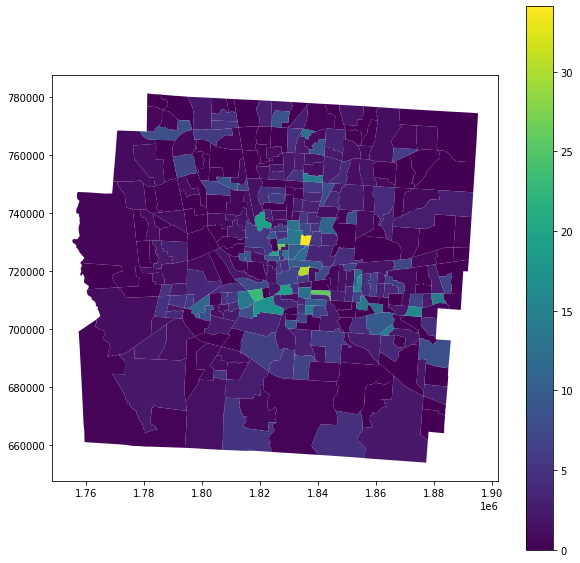

In [292]:
tractsEnriched.plot(column="No vehicles available (%)", cmap="viridis", legend=True, figsize=(10,10))

## Prototype the webmap

### First attempt (minimally configured)

In [268]:
m = tractsEnriched.explore(column="No vehicles available")
trails.explore(m=m, column="FacilityStatus")

### Second attempt (better configured)

In [269]:
m = tractsEnriched.explore(
    column="No vehicles available",
    cmap="summer",
    style_kwds={
        "fillOpacity":1
    }
)
trails.explore(m=m, 
    column="FacilityStatus", 
    cmap="Paired",
    style_kwds={
        "weight":2,
    }
)

### Final attempt (fully configured)

In [287]:
m = tractsEnriched.explore(
    column="No vehicles available (%)",
    scheme="FisherJenks",
    k=5,
    tiles="Esri.WorldGrayCanvas",
    cmap="viridis", 
    tooltip=False, 
    popup=commuteVars.values(), 
    highlight=False, 
    zoom_start=11,
    legend_kwds={
        "caption": "Percent of workers living in households with no vehicle available"
    }
)
trails.explore(m=m, 
    column="FacilityStatus", 
    cmap="Pastel1",
    style_kwds={"weight":3}, 
    tooltip=True
)

## Export the webmap

In [288]:
webmapDirectory = os.path.normpath("./docs")
if not os.path.exists(webmapDirectory):
    os.makedirs(webmapDirectory)
m.save(os.path.join(webmapDirectory, "index.html"))

# Demo of publishing using GitHub Pages

There are no slides to accompany this section since it was presented as a live demonstration. For implementation details, refer to the Jupyter notebook.

### Create a git repository

![Create a git repository using GitHub Desktop](./images/create_repo-02.png)

### Copy the webmap HTML file to the repository

![Copy the webmap HTML file to the new repository using the file browser](./images/folder_structure-01.png)

**Notes:**
  1. The file MUST be in the repository root or in a directory called "docs".
  1. The file SHOULD be called "index.html".

### Commit the webmap HTML file

![Commit the HTML export to git using GitHub Desktop](./images/commit_repo-01.png)

### Publish the respository to GitHub

![Publish the repository to GitHub using GitHub Desktop](./images/publish_repo-01.png)

### Enable GitHub Pages for the repository

![Enable the GitHub Pages feature for the repository in the repository settings page on the GitHub web site](./images/github_settings_pages-03.png)

### Access the webmap

![Access the published webmap in a browser via its GitHub Pages URL](./images/access_webmap-01.png)

**Notes:**
   1. The URL will have the format: `http://username.github.io/repository_name`
   1. If you didn't call the file `index.html`, you'll have to specify the file name like this:  `http://username.github.io/repository_name/filename.html`
   1. It may take a few minutes after enabling GitHub Pages or pushing a new version for the content to be available. 

# Thank you!

Questions?  Contact Adam Porr <aporr@morpc.org>